 ## 11. Stereographic Projection and Infinity

In [1]:
from spb import (
    PB,
    plot_complex,
    plot_geometry,
    plot3d_implicit
)
from sympy import (
    E,
    Eq,
    I,
    Line,
    nan,
    oo,
    pi,
    Piecewise,
    Plane,
    Point,
    Point3D,
    solveset,
    Symbol,
    symbols
)

 > Division by zero does not work; if attempted, it leads inevitably to paradoxes. Nevertheless, it is suggestive to think that the reciprocal $w = 1 / z$ of a complex number $z$ should approach infinity as $z$ approaches zero. This does not mean that there is a *number* $\infty$ in the field **C** of complex numbers, but it does mean that there is a geometric model which adds a "point" at "infinity" to the complex plane.

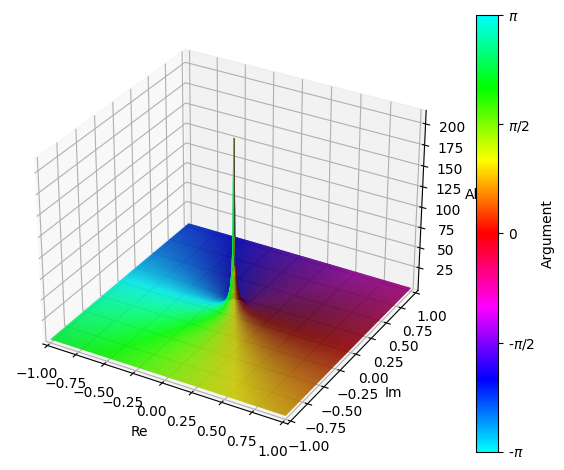

In [2]:
z = Symbol('z', complex=True)

w = 1 / z

plot_complex(
    w.subs(z, z),
    (z, -1+I*-1, 1+I*1),
    threed=True,
    use_cm=True,
    aspect='auto'
)

In [3]:
x, y, z = symbols('x y z')

p1 = plot3d_implicit(
    (x**2 + y**2 + (z-1)**2)-1,
    (x, -1, 1),
    (y, -1, 1),
    (z, 0, 2),
    show=False,
    rendering_kw={'opacity': .25},
    backend=PB
)

pS = Point(0, 0, 0)
pN = Point(0, 0, 2)
pP = Point(0, -1, 1)
pPp = Point(0, -2, 0)
pQ = Point(1, 0, 1)
pQp = Point(2, 0, 0)
pR = Point(-2, 0, 0)

Pl = Plane(pS, Point(1, 0, 0), Point(0, 1, 0))
PL = Plane(pN, pPp, pQp)
PLp = Plane(pN, pPp, pR)

lL = Line(pPp, pQp)
lLp = Line(pPp, pR)

p2 = plot_geometry(
    (Pl, (x, -3, 3), (y, -3, 3), (z, 0, 2)),
    (PL, (x, -.5, 2), (y, -2, .5), (z, -.5, 2.5)),
    (PLp, (x, -2, .5), (y, -2, .5), (z, -.5, 2.5)),
    (lL, 'L'),
    (lLp, 'L`'),
    (pS, '0'),
    (pN, 'N'),
    (pP, 'P'),
    (pPp, 'P`'),
    (pQ, 'Q'),
    (pQp, 'Q`'),
    (pR, 'R'),
    (Line(pN, pPp), 'N-P`'),
    (Line(pN, pQp), 'N-Q`'),
    show=False,
    backend=PB
)

p3 = plot3d_implicit(
    2*(x**2) + 2*(y**2) - 2*((2-z)**2),
    (x, -2, 2),
    (y, -2, 2),
    (z, 0, 2),
    rendering_kw={
        'opacity': .1,
        'colorscale': [[0, 'yellow'], [1, 'yellow']]
    },
    show=False,
    backend=PB
)

(p1 + p2 + p3).show()

In [4]:
r, theta = symbols('r θ')

expr1 = r*E**(I*theta)
expr2 = (1/r)*E**(-I*theta)

ext_com = Piecewise(
    (0, Eq(expr1, oo)),
    (expr2, expr1 != 0),
    (oo, True),
)

ext_com.subs({r: pi, theta: pi/4}).n()

0.225079079039277 - 0.225079079039277*I

In [5]:
ext_com.subs({r: 0, theta: -(pi/2)})

zoo

In [6]:
ext_com.subs(expr1, oo)

0

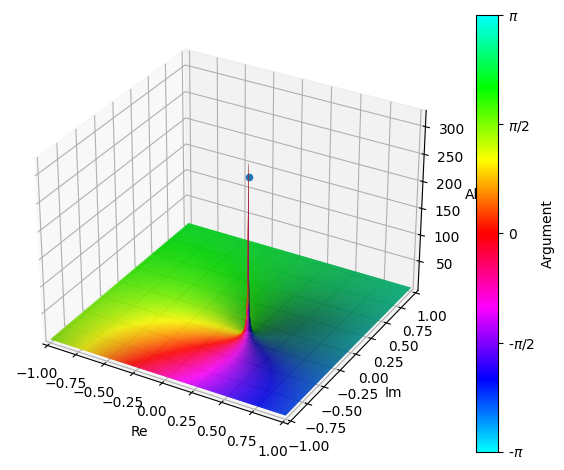

In [17]:
a, b, c, d = symbols('a b c d', complex=True)

frac_lin_trans = Piecewise(
    (False, (a*d - b*c) == 0),
    ((a*z + b)/(c*z + d), True)
)

c_sub = 0 + I*-7
d_sub = 2 + I*2

p4 = plot_complex(
    frac_lin_trans.subs({a: 1 + I*3, b: -4 + I*3, c: c_sub, d: d_sub}),
    (z, -1+I*-1, 1+I*1),
    threed=True,
    use_cm=True,
    aspect='auto',
    show=False
)

z1 = -d_sub/c_sub
z1r, z1i = z1.as_real_imag()
pZ1 = Point(z1r, z1i, 300)

p5 = plot_geometry(pZ1, show=False)

(p4 + p5).show()

In [19]:
z1.n()

0.285714285714286 - 0.285714285714286*I

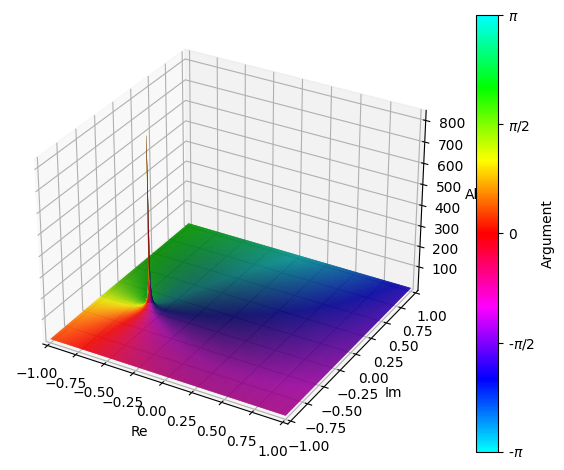

In [10]:
plot_complex(
    frac_lin_trans.subs({a: 4 + I*-2, b: -8 + I*-6, c: 7 + I*-7, d: 6 + I*-2}),
    (z, -1+I*-1, 1+I*1),
    threed=True,
    use_cm=True,
    aspect='auto'
)